# Demonstration for our model's ability in extending a dataset

For extending the dataset

In [ ]:
import sys
import os
from pathlib import Path
# notebook_dir = Path(os.getcwd())
project_root = Path("put_path_to_project_here")
sys.path.append(str(project_root))
sys.path.append(str(project_root / 'notebooks'))


In [ ]:
# config_path = project_root / 'notebooks/checkpoints/test-VUNet-wm-ori_2/config.yaml'
config_path = project_root / 'notebooks/configs/notebook_ffhq.yaml'

Load model

In [24]:
# Import the functions
from load_model import load_model_from_config, load_trainer_from_config, load_config_, load_model_

# Load the model and trainer
config = load_config_(config_path)
config['data']['train']['enabled'] = False
config['test']['test_only'] = True

# No compress
# config['log']['resume'] = '/home/yang/Documents/uwaterloo/experienments/restoration/DASR-SFT/notebooks/checkpoints/test-VUNet-wm-ori_1/model/incomplete/model_9.pt'

# Compress + Contra
config['hardware']['n_GPUs'] = 1

# Ablation 1
config['log']['resume'] = str(project_root / 'checkpoints' / 'ffhq.pt')

# Original
# config['log']['resume'] = 'checkpoints/test-VUNet-conv-ffhq-ori-lr_1_5-gan-ds_4/latest.pt'




# config['data']['patch_size'] = 128

# Rain's training set
config['data']['test'] = {
    'enabled': True,
    'type': 'Single_Dataset',
    'n_threads': 8,
    'batch_size': 1,
    'crop_size': 224,
    'list_type': 'paired_csv',
    'use_lmdb': False, # False,
    # 'db_basedir': '/home/yang/beluga/home/data/rain/data',
    # 'db_basedir': '/mnt/datamonster/data/wikimedia/wm_simulated/lmdb/data/',
    # The locations of DB in the config does not matter here, but we still need to present the keys
    'root': str(project_root / 'notebooks' / 'data'),
    'csv': str(project_root / 'notebooks' / 'data' / 'dummy.csv'),
    # 'csv': '/mnt/datamonster/data/wikimedia/wm_simulated/test_partial.csv',
    'csv_A_column': 'name',
    'csv_B_column': 'ref_name',
    'csv_path_is_relative': True,
    'suppress_crop': False
}

config['network']['netCprs']['enabled'] = True

model, logger = load_model_(config)

/home/paulyang/experienments/restoration/dasr/DASR-SFT-release/options/default.yaml


In [26]:

# config['log']['resume'] = None
# We are using a non-standard way of loading models
# Set this to None to suppress errors

trainer = load_trainer_from_config(model, config, logger)

# Now you can interact with the model and trainer
print(model)
print(trainer)

[*] Using GT: ref_name
[*] Loading model from checkpoint: /home/paulyang/experienments/restoration/dasr/DASR-SFT-release/checkpoints/ffhq.pt


/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/traitlets/config/application.py", line 1075, in launch_instance
    app.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel/kernelapp.py", line 701, in start
    self.io_loop.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/tornado/platform/asyncio.py", line 205, in start
    self.asyncio_loop.run_forever()

[*] Using degrade loss: dists, weight: 10
[*] Using color loss: rgbn, weight: 10.0
[*] Using loss type: l1, weight: 1
CombinedModel(
  (netG): BasicWrapper(
    (net): VUNet(
      (map_head): Conv2d(
        (activation): ReLU()
        (conv2d): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (conv_first): Conv2d(
        (conv2d): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (blocks1): ModuleList(
        (0-3): 4 x SFTResBlock(
          (sft1): SFTLayer(
            (convs_gamma): ModuleList(
              (0): Conv2d(
                (conv2d): Conv2d(8, 18, kernel_size=(1, 1), stride=(1, 1), bias=False)
              )
              (1): Conv2d(
                (activation): LeakyReLU(negative_slope=0.01)
                (conv2d): Conv2d(18, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
              )
            )
            (convs_beta): ModuleList(
              (0): Conv2d(
        

In [27]:
# %%writefile utils.py
# %load utils.py
import torch
from torchvision import transforms
import torchvision
from PIL import Image

def load_image(image_path):
    # image = Image.open(image_path)
    image = Image.open(image_path)
    image = image.convert('RGB')
    image = transforms.ToTensor()(image)
    # print(image.shape)
    # image = image.float() / 255
    preprocess = transforms.Compose([
        # transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    image = preprocess(image)
    # print(image.max(), image.min())
    return image

def forward_gen(x_0, eg, el):
    random_state = torch.randn_like(x_0[:,:1,:,:])
    x_0 = torch.concat([x_0, random_state], dim=1)
    return model.netG(x_0, eg, el, model.pos_emb)


## Compression settings

In [28]:
COMPRESS_G = False
COMPRESS_L = True

Perform analysis on local

For reproducibility, we have selected a few images with different comination of degradations for demonstration.  

In [29]:
import torchvision.transforms.functional as VF
PATCH_SIZE = 320

def get_image(img_path: str):
    img = Image.open(img_path).convert('RGB')
    img = VF.center_crop(img, [PATCH_SIZE, PATCH_SIZE])
    img = trainer.loaders['test'].dataset.transform(img)
    return img[:3, :, :]

def load_image_patches(folder_name):
    # Define the path to the images folder
    images_folder = folder_name

    # List all image files in the folder
    image_files = [f for f in os.listdir(images_folder) if os.path.isfile(os.path.join(images_folder, f))]
    image_files.sort()

    # Load each image using the get_image function
    loaded_images = [get_image(os.path.join(images_folder, img_file)) for img_file in image_files]

    return loaded_images

In [30]:
distorted_images = load_image_patches(project_root / 'notebooks' / 'images/ffhq-x/dist')
pristine_images = load_image_patches(project_root / 'notebooks' / 'images/ffhq-x/pres')

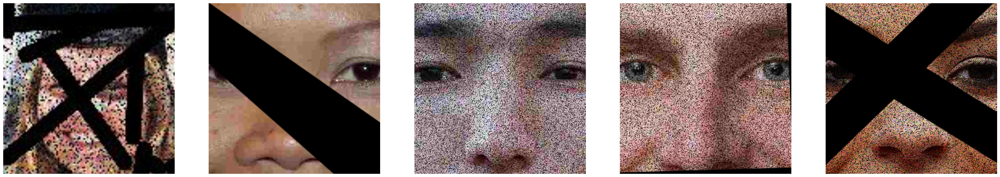

In [31]:
import matplotlib.pyplot as plt

# Create a figure to display the images
fig, axs = plt.subplots(1, len(distorted_images), figsize=(40, 8))

# Display each loaded image
for i, img in enumerate(distorted_images):
    axs[i].imshow((img.cpu().numpy().transpose(1, 2, 0) + 1) / 2)
    axs[i].axis('off')

plt.show()


## Image Degradation Transfer (Local + Global from the same source)

In [32]:
import torch

generated_images = []
with torch.no_grad():
    # Loop over each index to vary
    for i, x_0 in enumerate(pristine_images):
        this_images = [ ] 
        x_0 = x_0.unsqueeze(0).cuda() # raw_datas[i]['B_img'].cuda()
        for j, y_0 in enumerate(distorted_images):
            
            y_0 = y_0.unsqueeze(0).cuda()# raw_datas[j]['A_img'][:, 0].cuda()
            # y_ori = distorted_images[i].unsqueeze(0).cuda()
            eg = model.forward_latent(y_0, COMPRESS_G)
            # eg = model.forward_latent(y_ori, COMPRESS_G)
            el = model.forward_latent_local(y_0, COMPRESS_L)
            y_hat = forward_gen(x_0, eg, el)
            this_images.append(y_hat.detach().cpu())
            del eg, el, y_hat
            print(i, j, len(this_images))
        print(len(this_images))
        generated_images.append(this_images)



/home/paulyang/experienments/restoration/dasr/DASR-SFT-release/model/vunet_conv.py:305: UserWarning: pos_emb is not used in this wrapper.
  warnings.warn("pos_emb is not used in this wrapper.")
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/traitlets/config/application.py", line 1075, in launch_instance
    app.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel/kernelapp.py", line 701, in start
    self.io_loop.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/tornado/platform/asyncio.py", line 205, in start
    self.asyncio_loop.run_forever()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/py

0 0 1
0 1 2
0 2 3
0 3 4
0 4 5
5
1 0 1
1 1 2
1 2 3
1 3 4
1 4 5
5
2 0 1
2 1 2
2 2 3
2 3 4
2 4 5
5
3 0 1
3 1 2
3 2 3
3 3 4
3 4 5
5
4 0 1
4 1 2
4 2 3
4 3 4
4 4 5
5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

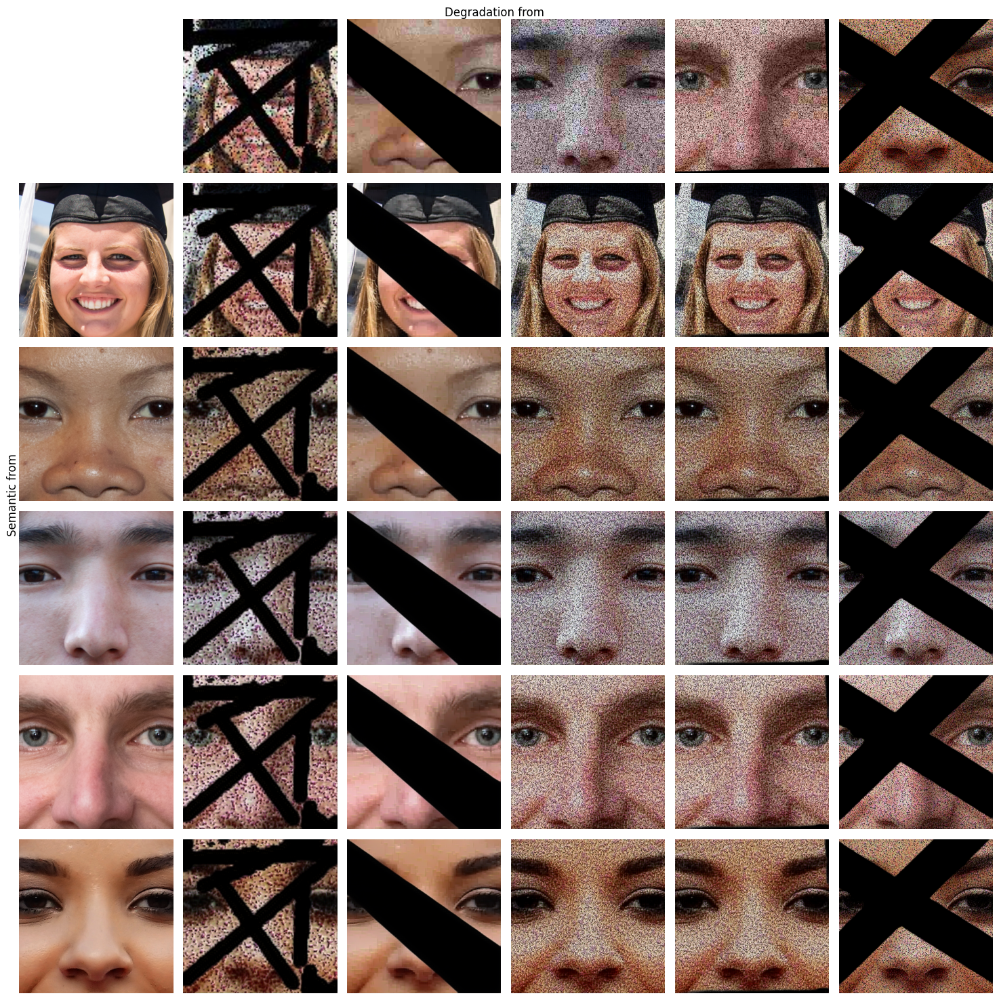

In [33]:
fig, axs = plt.subplots(len(pristine_images) + 1, len(distorted_images) + 1, figsize=(15, 15))

axs[0, 0].axis('off')

# Plot x_0 images in the 0th column
for i, x_0 in enumerate(pristine_images):
    x_0_img = x_0.cpu().numpy().transpose(1, 2, 0)
    x_0_img = (x_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[i + 1, 0].imshow(x_0_img)
    axs[i + 1, 0].axis('off')

# Plot y_0 images in the 0th row
for j, y_0 in enumerate(distorted_images):
    y_0_img = y_0.cpu().numpy().transpose(1, 2, 0)
    y_0_img = (y_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[0, j + 1].imshow(y_0_img)
    axs[0, j + 1].axis('off')

# Plot generated images in the body grids
for i, x_0 in enumerate(pristine_images):
    for j, y_0 in enumerate(distorted_images):
        gen_img = generated_images[i][j][0].numpy().transpose(1, 2, 0)
        gen_img = (gen_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
        axs[i + 1, j + 1].imshow(gen_img)
        axs[i + 1, j + 1].axis('off')
del x_0, y_0

# fig.supxlabel("Degradation from")
fig.supylabel("Semantic from")
fig.suptitle('Degradation from')

plt.tight_layout()
plt.savefig('output_figure_2.pdf', format='pdf')

plt.show()




## Image Degradation Transfer (Local only)

Global degradation is kept as-is. 

In [40]:
import torch

generated_images = []
with torch.no_grad():
    # Loop over each index to vary
    for i, x_0 in enumerate(pristine_images):
        this_images = [ ] 
        x_0 = x_0.unsqueeze(0).cuda() # raw_datas[i]['B_img'].cuda()
        for j, y_0 in enumerate(distorted_images):
            
            y_0 = y_0.unsqueeze(0).cuda()# raw_datas[j]['A_img'][:, 0].cuda()
            y_ori = distorted_images[i].unsqueeze(0).cuda()
            # eg = model.forward_latent(y_0, COMPRESS_G)
            eg = model.forward_latent(y_ori, COMPRESS_G)
            el = model.forward_latent_local(y_0, COMPRESS_L)
            y_hat = forward_gen(x_0, eg, el)
            this_images.append(y_hat.detach().cpu())
            del eg, el, y_hat
            print(i, j, len(this_images))
        print(len(this_images))
        generated_images.append(this_images)



/home/paulyang/experienments/restoration/dasr/DASR-SFT-release/model/vunet_conv.py:305: UserWarning: pos_emb is not used in this wrapper.
  warnings.warn("pos_emb is not used in this wrapper.")
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/traitlets/config/application.py", line 1075, in launch_instance
    app.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel/kernelapp.py", line 701, in start
    self.io_loop.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/tornado/platform/asyncio.py", line 205, in start
    self.asyncio_loop.run_forever()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/py

0 0 1
0 1 2
0 2 3
0 3 4
0 4 5
5
1 0 1
1 1 2
1 2 3
1 3 4
1 4 5
5
2 0 1
2 1 2
2 2 3
2 3 4
2 4 5
5
3 0 1
3 1 2
3 2 3
3 3 4
3 4 5
5
4 0 1
4 1 2
4 2 3
4 3 4
4 4 5
5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

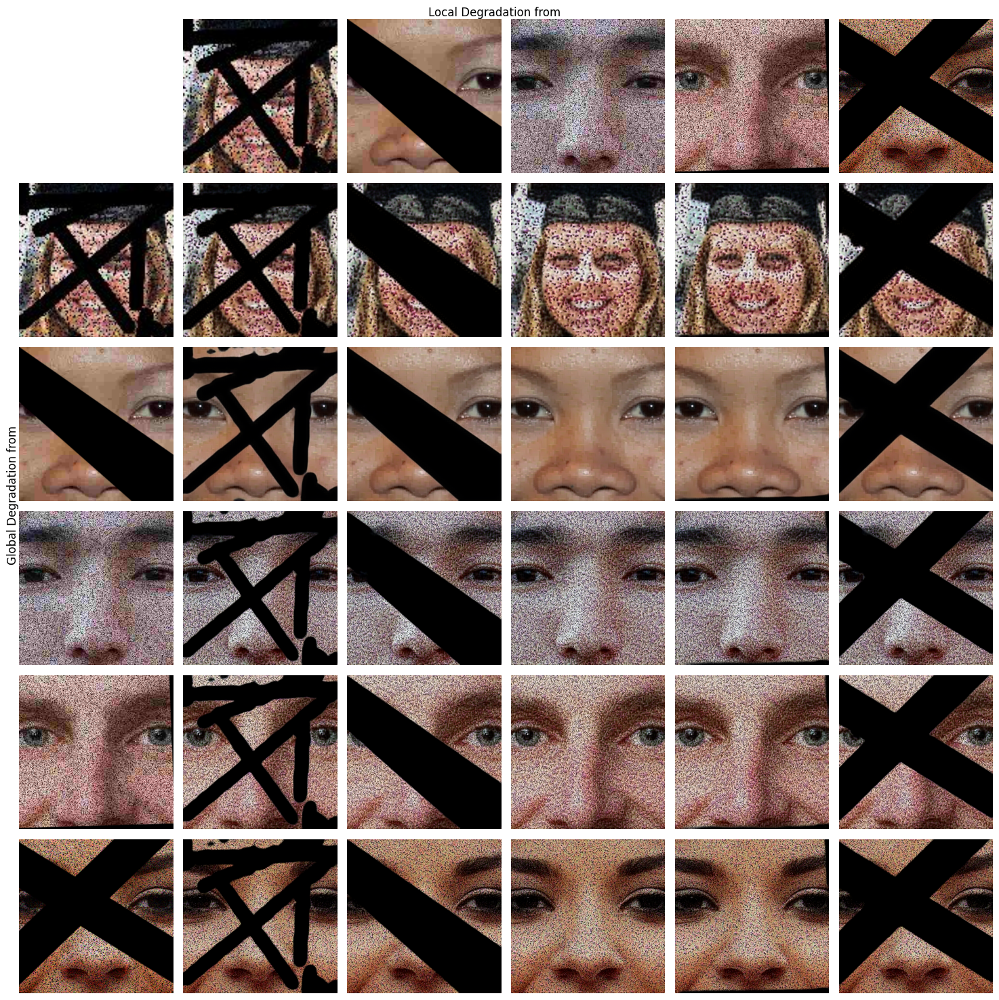

In [39]:
fig, axs = plt.subplots(len(pristine_images) + 1, len(distorted_images) + 1, figsize=(15, 15))

axs[0, 0].axis('off')

# Plot x_0 images in the 0th column
for i, x_0 in enumerate(distorted_images):
    x_0_img = x_0.cpu().numpy().transpose(1, 2, 0)
    x_0_img = (x_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[i + 1, 0].imshow(x_0_img)
    axs[i + 1, 0].axis('off')

# Plot y_0 images in the 0th row
for j, y_0 in enumerate(distorted_images):
    y_0_img = y_0.cpu().numpy().transpose(1, 2, 0)
    y_0_img = (y_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[0, j + 1].imshow(y_0_img)
    axs[0, j + 1].axis('off')

# Plot generated images in the body grids
for i, x_0 in enumerate(pristine_images):
    for j, y_0 in enumerate(distorted_images):
        gen_img = generated_images[i][j][0].numpy().transpose(1, 2, 0)
        gen_img = (gen_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
        axs[i + 1, j + 1].imshow(gen_img)
        axs[i + 1, j + 1].axis('off')
del x_0, y_0

# fig.supxlabel("Degradation from")
fig.supylabel("Global Degradation from")
fig.suptitle('Local Degradation from')

plt.tight_layout()
plt.savefig('output_figure_2.pdf', format='pdf')

plt.show()




## Image Degradation Transfer (Global only)

Local degradation is not added back. 

In [41]:
import torch

generated_images = []
with torch.no_grad():
    # Loop over each index to vary
    for i, x_0 in enumerate(pristine_images):
        this_images = [ ] 
        x_0 = x_0.unsqueeze(0).cuda() # raw_datas[i]['B_img'].cuda()
        for j, y_0 in enumerate(distorted_images):
            
            y_0 = y_0.unsqueeze(0).cuda()# raw_datas[j]['A_img'][:, 0].cuda()
            # y_ori = distorted_images[i].unsqueeze(0).cuda()
            eg = model.forward_latent(y_0, COMPRESS_G)
            # eg = model.forward_latent(y_ori, COMPRESS_G)
            el = model.forward_latent_local(x_0, COMPRESS_L)
            y_hat = forward_gen(x_0, eg, el)
            this_images.append(y_hat.detach().cpu())
            del eg, el, y_hat
            print(i, j, len(this_images))
        print(len(this_images))
        generated_images.append(this_images)



0 0 1
0 1 2
0 2 3
0 3 4
0 4 5
5
1 0 1
1 1 2
1 2 3
1 3 4
1 4 5
5
2 0 1
2 1 2
2 2 3
2 3 4
2 4 5
5
3 0 1
3 1 2
3 2 3
3 3 4
3 4 5
5
4 0 1
4 1 2
4 2 3
4 3 4
4 4 5
5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

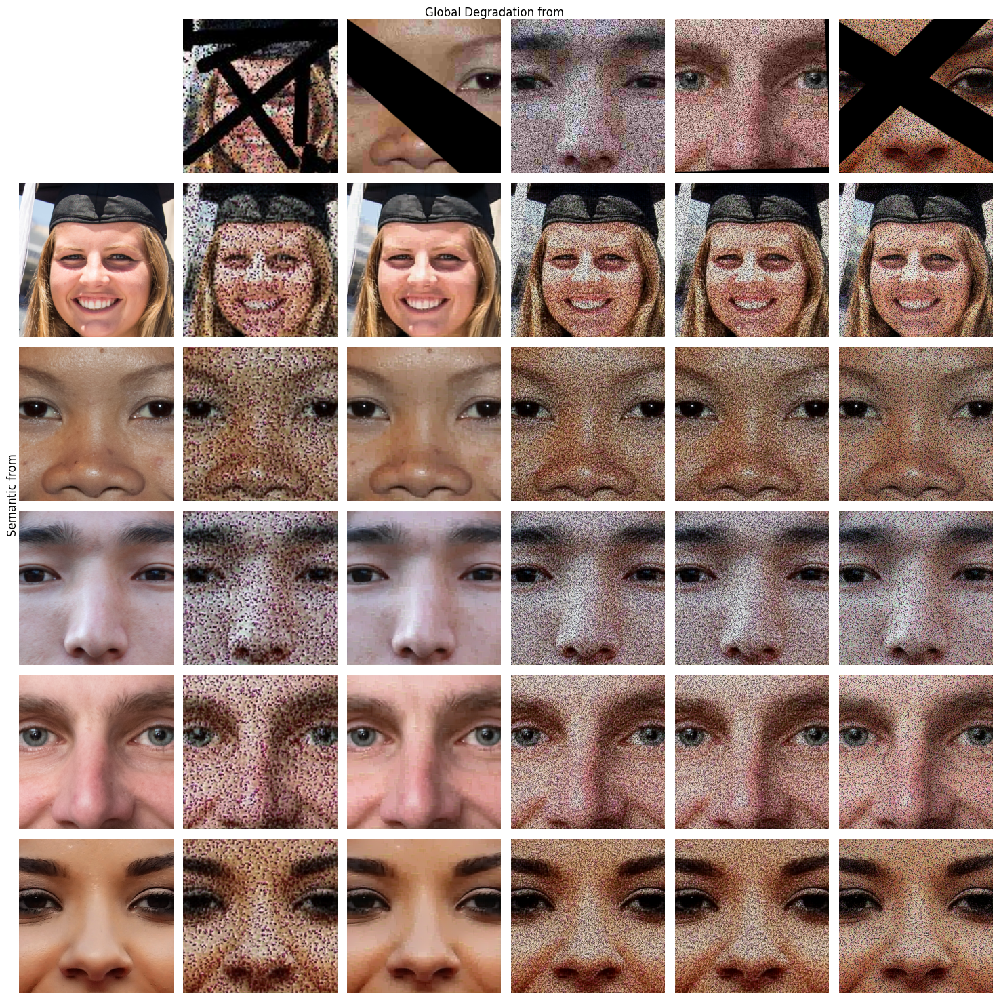

In [42]:
fig, axs = plt.subplots(len(pristine_images) + 1, len(distorted_images) + 1, figsize=(15, 15))

axs[0, 0].axis('off')

# Plot x_0 images in the 0th column
for i, x_0 in enumerate(pristine_images):
    x_0_img = x_0.cpu().numpy().transpose(1, 2, 0)
    x_0_img = (x_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[i + 1, 0].imshow(x_0_img)
    axs[i + 1, 0].axis('off')

# Plot y_0 images in the 0th row
for j, y_0 in enumerate(distorted_images):
    y_0_img = y_0.cpu().numpy().transpose(1, 2, 0)
    y_0_img = (y_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[0, j + 1].imshow(y_0_img)
    axs[0, j + 1].axis('off')

# Plot generated images in the body grids
for i, x_0 in enumerate(pristine_images):
    for j, y_0 in enumerate(distorted_images):
        gen_img = generated_images[i][j][0].numpy().transpose(1, 2, 0)
        gen_img = (gen_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
        axs[i + 1, j + 1].imshow(gen_img)
        axs[i + 1, j + 1].axis('off')
del x_0, y_0

# fig.supxlabel("Degradation from")
fig.supylabel("Semantic from")
fig.suptitle('Global Degradation from')

plt.tight_layout()
plt.savefig('output_figure_2.pdf', format='pdf')

plt.show()


## Image Degradation Transfer (Local only)

Local degradation is not added back. 

In [43]:
generated_images = []
with torch.no_grad():
    # Loop over each index to vary
    for i, x_0 in enumerate(pristine_images):
        this_images = [ ] 
        x_0 = x_0.unsqueeze(0).cuda() # raw_datas[i]['B_img'].cuda()
        for j, y_0 in enumerate(distorted_images):
            
            y_0 = y_0.unsqueeze(0).cuda()# raw_datas[j]['A_img'][:, 0].cuda()
            # y_ori = distorted_images[i].unsqueeze(0).cuda()
            eg = model.forward_latent(x_0, COMPRESS_G)
            # eg = model.forward_latent(y_ori, COMPRESS_G)
            el = model.forward_latent_local(y_0, COMPRESS_L)
            y_hat = forward_gen(x_0, eg, el)
            this_images.append(y_hat.detach().cpu())
            del eg, el, y_hat
            print(i, j, len(this_images))
        print(len(this_images))
        generated_images.append(this_images)



/home/paulyang/experienments/restoration/dasr/DASR-SFT-release/model/vunet_conv.py:305: UserWarning: pos_emb is not used in this wrapper.
  warnings.warn("pos_emb is not used in this wrapper.")
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/traitlets/config/application.py", line 1075, in launch_instance
    app.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/ipykernel/kernelapp.py", line 701, in start
    self.io_loop.start()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/python3.12/site-packages/tornado/platform/asyncio.py", line 205, in start
    self.asyncio_loop.run_forever()
  File "/home/paulyang/anaconda3/envs/torch22compress/lib/py

0 0 1
0 1 2
0 2 3
0 3 4
0 4 5
5
1 0 1
1 1 2
1 2 3
1 3 4
1 4 5
5
2 0 1
2 1 2
2 2 3
2 3 4
2 4 5
5
3 0 1
3 1 2
3 2 3
3 3 4
3 4 5
5
4 0 1
4 1 2
4 2 3
4 3 4
4 4 5
5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

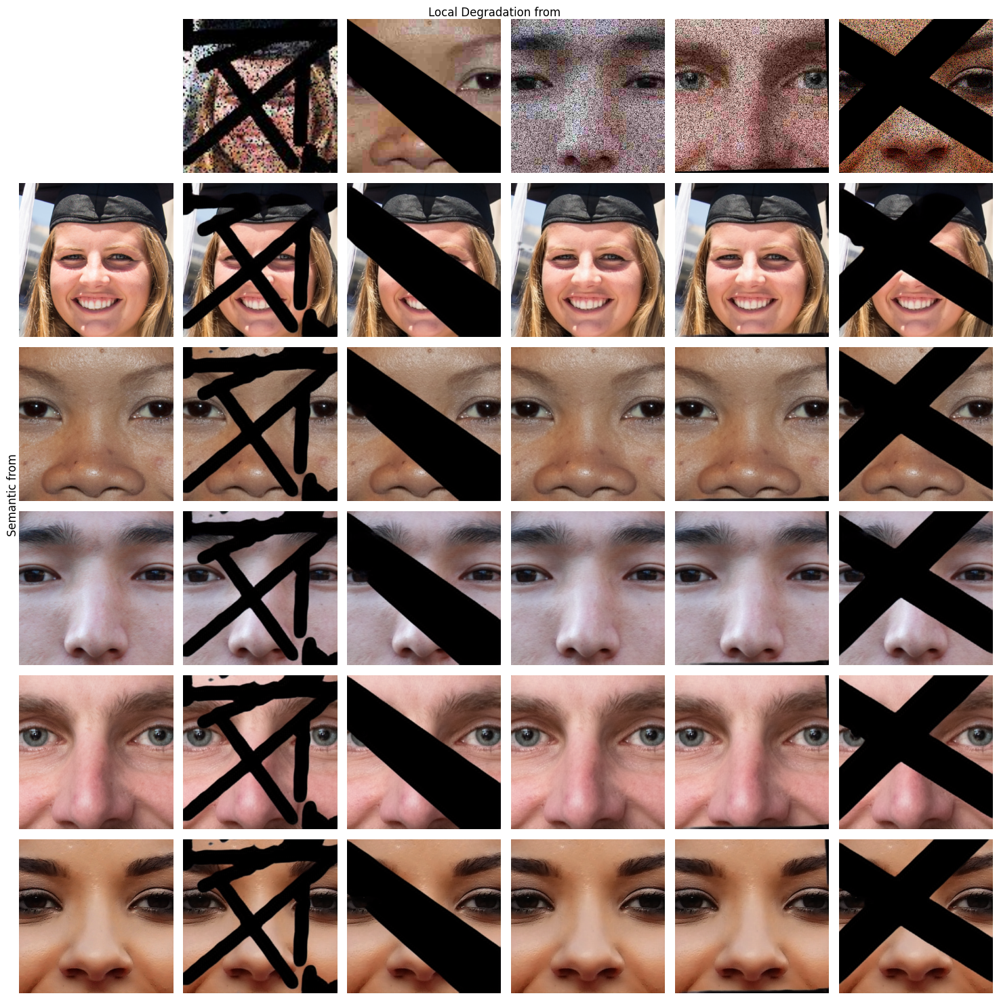

In [44]:
fig, axs = plt.subplots(len(pristine_images) + 1, len(distorted_images) + 1, figsize=(15, 15))

axs[0, 0].axis('off')

# Plot x_0 images in the 0th column
for i, x_0 in enumerate(pristine_images):
    x_0_img = x_0.cpu().numpy().transpose(1, 2, 0)
    x_0_img = (x_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[i + 1, 0].imshow(x_0_img)
    axs[i + 1, 0].axis('off')

# Plot y_0 images in the 0th row
for j, y_0 in enumerate(distorted_images):
    y_0_img = y_0.cpu().numpy().transpose(1, 2, 0)
    y_0_img = (y_0_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
    axs[0, j + 1].imshow(y_0_img)
    axs[0, j + 1].axis('off')

# Plot generated images in the body grids
for i, x_0 in enumerate(pristine_images):
    for j, y_0 in enumerate(distorted_images):
        gen_img = generated_images[i][j][0].numpy().transpose(1, 2, 0)
        gen_img = (gen_img + 1) / 2  # Scale from [-1, 1] to [0, 1]
        axs[i + 1, j + 1].imshow(gen_img)
        axs[i + 1, j + 1].axis('off')
del x_0, y_0

# fig.supxlabel("Degradation from")
fig.supylabel("Semantic from")
fig.suptitle('Local Degradation from')

plt.tight_layout()
plt.savefig('output_figure_2.pdf', format='pdf')

plt.show()